# Imports and installations 

In [4]:
import wget    
import glob
#import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import cv2
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from PIL import Image
Image.MAX_IMAGE_PIXELS = None
import glob
from sklearn.model_selection import train_test_split
import tensorflow as tf
from sklearn import preprocessing
import skimage as ski
from tensorflow.keras import layers
import keras
import datetime
import os 
import scanpy as sc
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score
import random 


# Helper functions 

In [10]:
def image_to_windows(image, size, step, ch):
    image_windows = ski.util.view_as_windows(image, (size, size, ch), step=step)
    image_shape = np.shape(image_windows)
    image_windows = image_windows.reshape(((image_shape[0] * image_shape[1]), size, size, ch))  # reshape to Nx375x375x3
    return image_windows, image_shape

def remove_blank_windows(image_windows, threshold=210): 
    image_windows_nbg = []
    for i in image_windows:
        if i.mean() < threshold:
            image_windows_nbg.append(i)

    image_windows_nbg = np.array((image_windows_nbg))
    return image_windows_nbg
def save_data(windows, savename,savepath):
    for i in range(len(windows)):
        np.save(savepath+savename +'_'+ str(i)+'.npy', windows[i])
    return 

def preprocess_and_save(image_path, dataset_name, savepath, tile_size):

    # Load image
    image = mpimg.imread(image_path)

    # Split into windows and remove blank white windows
    windows, image_w_shape = image_to_windows(image, tile_size, tile_size, 3)
    windows_br = remove_blank_windows(windows)

    # Save 
    save_data(windows_br, dataset_name, savepath)

    # Make space for next 
    del image 
    del windows
    del image_w_shape
    del windows_br
    return 




# Preprocessing of images 
Download images, split into tiles and save

In [4]:
def download_full_resolution_images(): 
  ''' Downloads full resolution 10x genomic prostate images ''' 
  # Download normal image 
  !wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_image.jpg

  # Download invasive adenocarcinoma image
  !wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_image.tif

  # Download acinar cellular carcinoma image
  !wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_image.tif
  return 

#download_full_resolution_images()

--2022-11-08 08:48:13--  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_image.jpg
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.0.173, 104.18.1.173, 2606:4700::6812:ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.0.173|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 369729329 (353M) [image/jpeg]
Saving to: ‘Visium_FFPE_Human_Normal_Prostate_image.jpg’

Visium_FFPE_Human_N 100%[===================>] 352.60M   188MB/s    in 1.9s    

2022-11-08 08:48:15 (188 MB/s) - ‘Visium_FFPE_Human_Normal_Prostate_image.jpg’ saved [369729329/369729329]

--2022-11-08 08:48:15--  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_image.tif
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.0.173, 104.18.1.173, 2606:4700::6812:ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18

Split normal images into 224x224 windows around spot centre 

In [4]:
def split_images_to_windows(tile_size=224):

  # Normal 
  savepath = str(tile_size) + '_windows/'
  os.mkdir(str(tile_size) + '_windows')
  print('Spliting normal ...')
  image_path = 'slide1.jpg'
  dataset_name = 'Normal'
  preprocess_and_save(image_path, dataset_name, savepath, tile_size)

  # Invasive adenocarcinoma
  print('Splitting invasive adenocarcinoma..')
  image_path = 'slide2.tif'
  dataset_name = 'IAC'
  preprocess_and_save(image_path, dataset_name, savepath, tile_size)

  # Acinar cellular carcinoma 
  print('Spliting acinar cellular carcinoma ...')
  image_path = 'slide3.tif'
  dataset_name = 'ACC'
  preprocess_and_save(image_path, dataset_name, savepath, tile_size)
  return 


In [7]:
split_images_to_windows(tile_size=224)

Spliting normal ...
Splitting invasive adenocarcinoma..
Spliting acinar cellular carcinoma ...


# Training VAE 

All the H&E images were split into windows and used to train the VAE as a feature extractor

In [32]:
import keras
class AE(keras.Model): 
    def __init__(self, latent_dim):
        super(AE, self).__init__()
        self.latent_dim = latent_dim   

        encoder_inputs = keras.Input(shape=(224, 224, 3))
        x = layers.Conv2D(64, 3, activation="relu", strides=2, padding="same")(encoder_inputs)
        x = layers.Conv2D(128, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2D(256, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2D(512, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Flatten()(x)
        z = layers.Dense(self.latent_dim, activation="relu")(x)
        self.encoder =  keras.Model(encoder_inputs, z, name="encoder")

        latent_inputs = keras.Input(shape=(self.latent_dim,))
        x = layers.Dense(14 * 14 * 64, activation="relu")(latent_inputs)
        x = layers.Reshape((14, 14, 64))(x)
        x = layers.Conv2DTranspose(512, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2DTranspose(256, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2DTranspose(128, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2DTranspose(64, 3, activation="relu", strides=2, padding="same")(x)
        decoder_outputs = layers.Conv2DTranspose(3, 3, activation="sigmoid", padding="same")(x)
        self.decoder = keras.Model(latent_inputs, decoder_outputs, name="decoder")

        self.reconstruction_loss_tracker = keras.metrics.Mean(
            name="reconstruction_loss"
        )
        
    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
    
    @property
    def metrics(self):
        return [
            self.reconstruction_loss_tracker
        ]

    def train_step(self, data):
        with tf.GradientTape() as tape:
            #data = data_augmentation(data)
            z = self.encoder(data)
            reconstruction = self.decoder(z)
            reconstruction_loss = tf.reduce_mean(
                tf.reduce_sum(
                    keras.losses.binary_crossentropy(data, reconstruction), axis=(1, 2)
                )
            )
        grads = tape.gradient(reconstruction_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)

        return {
            "reconstruction_loss": self.reconstruction_loss_tracker.result(),
        }

In [29]:
class DataGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data_path, batch_size=1, dim=(128,128), n_channels=3,
                 n_classes=10, shuffle=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.list_IDs = data_path
        #self.list_labels = data_path[1]
        self.n_channels = n_channels
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs and labels
        list_IDs_temp = [self.list_IDs[k] for k in indexes]
        #labels_temp = [self.list_labels[k] for k in indexes]


        # Generate data
        x = self.__data_generation(list_IDs_temp)

        return x

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, list_IDs_temp):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        X = []

        # Generate data
        for i in range(len(list_IDs_temp)):

            x_temp = np.load(list_IDs_temp[i])
        
            # Invert and normalize 
            x_temp = invert_image_normalize(x_temp)

            X.append(x_temp)
        return np.array(X, dtype='float32')

In [6]:
images_dir = glob.glob('224_windows/*')
vae_image_gen = DataGenerator(images_dir)

In [38]:
# Invert  and normalize
def invert_image_normalize(image):
    image = np.array(image)
    return (255 - image) / 255 

In [ ]:
callback = tf.keras.callbacks.EarlyStopping(
    monitor='reconstruction_loss',
    patience=3
)
vae = AE(512)
vae.compile(optimizer=keras.optimizers.Adam())


In [55]:
#vae.load_weights('AE_weights_1912')
vae.fit(vae_image_gen, epochs=100, callbacks=callback) 

Epoch 1/100
16794/16794 [==============================] - 402s 24ms/step - reconstruction_loss: 28102.3867
Epoch 2/100
16794/16794 [==============================] - 348s 21ms/step - reconstruction_loss: 28100.2207
Epoch 3/100
16794/16794 [==============================] - 368s 22ms/step - reconstruction_loss: 28097.9375
Epoch 4/100
16794/16794 [==============================] - 377s 22ms/step - reconstruction_loss: 28096.3301
Epoch 5/100
16794/16794 [==============================] - 279s 17ms/step - reconstruction_loss: 28095.5742
Epoch 6/100
16794/16794 [==============================] - 294s 17ms/step - reconstruction_loss: 28093.4297
Epoch 7/100
16794/16794 [==============================] - 285s 17ms/step - reconstruction_loss: 28092.6016
Epoch 8/100
16794/16794 [==============================] - 319s 19ms/step - reconstruction_loss: 28092.5039
Epoch 9/100
16794/16794 [==============================] - 286s 17ms/step - reconstruction_loss: 28090.2480
Epoch 10/100
16794/16794 [==

In [56]:
vae.save_weights('AE_weights_1912')

In [ ]:
vae.load_weights

# Example reconstructed image (left) and original (right)

In [57]:
rng = np.random.default_rng(0)
rints = rng.integers(low=0, high=len(vae_image_gen), size=4)

In [58]:
rints

array([14285, 10697,  8584,  4530], dtype=int64)

In [40]:
def invert_image_normalize(image):
    return (255 - image) / 255 

def reverse_invert_image(inverted_image):
    return 1 - inverted_image

def predict(vae, x, inverted):
    z = vae.encoder(x.reshape(1,224,224,3))
    recon = vae.decoder(z)
    recon = np.reshape(recon,(224,224,3))

    x_reverse_inverted = reverse_invert_image(x)
    recon_reverse_inverted = reverse_invert_image(recon)

    fig, ax = plt.subplots(1,2)
    ax[0].imshow(recon_reverse_inverted)
    ax[1].imshow(x_reverse_inverted)

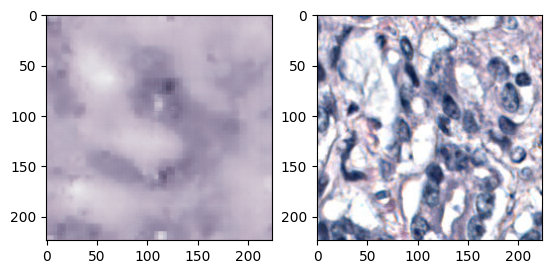

In [59]:
x = vae_image_gen.__getitem__(rints[0]).reshape(224,224,3)
predict(vae, x, inverted=True)

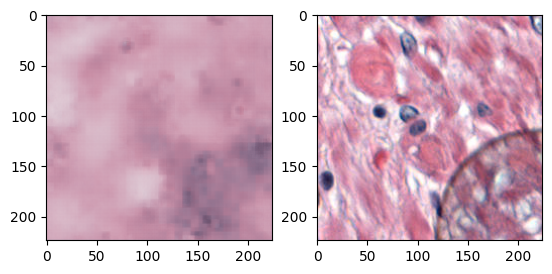

In [60]:
x = vae_image_gen.__getitem__(rints[1]).reshape(224,224,3)
predict(vae, x, inverted=True)

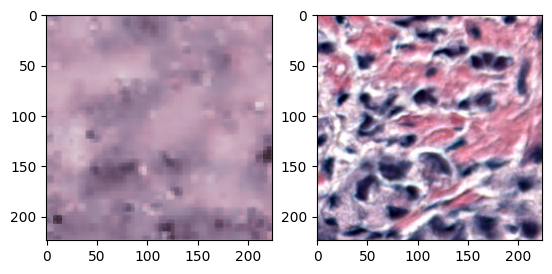

In [61]:
x = vae_image_gen.__getitem__(rints[2]).reshape(224,224,3)
predict(vae, x, inverted=True)

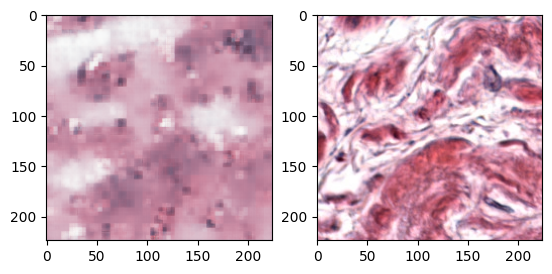

In [62]:
x = vae_image_gen.__getitem__(rints[3]).reshape(224,224,3)
predict(vae, x, inverted=True)

# Training classifier 

In [28]:
def download_adata():
  ''' 
  Downloads:
  1. Human matrisome list 
  2. Three x10 Genomics prostate datasets - Normal, Invasive adenocarcinoma & acinar cellular carcinoma 
  ''' 

  # Matrisome masterlist 
  #!wget http://matrisomeproject.mit.edu/static/media/uploads/Files/Human%20in%20silico%20matrisome/matrisome_hs_masterlist.xls
  !curl http://matrisomeproject.mit.edu/static/media/uploads/Files/Human%20in%20silico%20matrisome/matrisome_hs_masterlist.xls --output matrisome_hs_masterilist.xls


  # Download normal dataset, unzip & place in appropriate folder  
  os.mkdir('Normal')
  #!wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_filtered_feature_bc_matrix.h5
  !curl  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_filtered_feature_bc_matrix.h5 --output Visium_FFPE_Human_Normal_Prostate_filtered_feature_bc_matrix.h5
  #!wget  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_spatial.tar.gz
  !curl https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_spatial.tar.gz --output Visium_FFPE_Human_Normal_Prostate_spatial.tar.gz
  !tar -xzvf Visium_FFPE_Human_Normal_Prostate_spatial.tar.gz
  os.replace('spatial', 'Normal/spatial')

  # Download invasive adenocarcinoma dataset 
  os.mkdir('IAC')
  #!wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_filtered_feature_bc_matrix.h5  
  !curl https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_filtered_feature_bc_matrix.h5   --output Visium_FFPE_Human_Prostate_Cancer_filtered_feature_bc_matrix.h5
  #!wget  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_spatial.tar.gz
  !curl https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_spatial.tar.gz --output Visium_FFPE_Human_Prostate_Cancer_spatial.tar.gz
  !tar -xzvf Visium_FFPE_Human_Prostate_Cancer_spatial.tar.gz
  os.replace('spatial', 'IAC/spatial')
  

  # Download acinar cellular carcinoma dataset 
  os.mkdir('ACC')
  #!wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_filtered_feature_bc_matrix.h5
  !curl https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_filtered_feature_bc_matrix.h5 --output Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_filtered_feature_bc_matrix.h5
  #!wget  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_spatial.tar.gz
  !curl https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_spatial.tar.gz --output Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_spatial.tar.gz
  !tar -xzvf Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_spatial.tar.gz
  os.replace('spatial', 'ACC/spatial')

  print('/n - - - - - - - - - - - ')
  print('Downloads complete')
  print(' - - - - - - - - - - - ')
  return 

 # Download adata's  
download_adata()

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
 55  370k   55  203k    0     0   339k      0  0:00:01 --:--:--  0:00:01  339k
100  370k  100  370k    0     0   520k      0 --:--:-- --:--:-- --:--:--  519k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
 19 9088k   19 1750k    0     0  2101k      0  0:00:04 --:--:--  0:00:04 2101k
 78 9088k   78 7158k    0     0  3858k      0  0:00:02  0:00:01  0:00:01 3859k
100 9088k  100 9088k    0     0  4158k      0  0:00:02  0:00:02 --:--:-- 4161k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   


 - - - - - - - - - - - 
Downloads complete
 - - - - - - - - - - - 


x spatial/
x spatial/tissue_lowres_image.png
x spatial/detected_tissue_image.jpg
x spatial/scalefactors_json.json
x spatial/tissue_hires_image.png
x spatial/tissue_positions_list.csv
x spatial/aligned_fiducials.jpg


**NOTE** Directly upload the 'Pathology_unlabeled.csv' from GitHub file into colabs 

In [64]:
import pandas as pd

In [84]:
# NOTE MANUAL UPLOADING OF 

def load_annotated_data(dataset_name):

    if dataset_name not in ['Normal', 'IAC', 'ACC']:
        print('Select dataset_name from: Normal, IAC, ACC')

    # Load Normal adata and image 
    if dataset_name == 'Normal':
        pf = 'Normal'
        cf = 'Visium_FFPE_Human_Normal_Prostate_filtered_feature_bc_matrix.h5'
        tissue_positions = pd.read_csv('Normal/spatial/tissue_positions_list.csv')
        full_res_img_path = 'slide1.jpg'

    # Load Stage 3 adata and image 
    if dataset_name == 'IAC':
        pf = 'IAC'
        cf = 'Visium_FFPE_Human_Prostate_Cancer_filtered_feature_bc_matrix.h5'
        tissue_positions = pd.read_csv('IAC/spatial/tissue_positions_list.csv')
        full_res_img_path = 'slide2.tif'
        
    if dataset_name == 'ACC':
        pf = 'ACC'
        cf = 'Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_filtered_feature_bc_matrix.h5'
        tissue_positions = pd.read_csv('ACC/spatial/tissue_positions_list.csv')
        full_res_img_path = 'slide3.tif'

    # Load adata
    print('\n --------------------- ')
    print('Loading adata...')
    adata = sc.read_visium(pf, genome=None, count_file=cf , library_id=None, load_images=True,
                        source_image_path=None)

    # Loads binary version of pathologist notes (only available for IAC)
    if dataset_name == 'IAC':
        print('\n --------------------- ')
        print('Loading histopathologist annotations...')
        path = 'C:/Users/MG/OneDrive - The University of Manchester/WT_IMC_PhD/Year One - 2021/Spatial_Transcriptomics_of_Prostate_Tumour_Matrisome/Pathology_unlabeled.csv'
        pathologist_ann = pd.read_csv(path)
        print('\n --------------------- ')
        print('Converting below to non-malignat excluding nan:')
        print(pathologist_ann['Pathology'].unique())
        pathologist_ann['Binary_labels'] = pathologist_ann['Pathology'].replace('Normal gland', 'Non-malignant').replace('Fibro-muscular tissue', 'Non-malignant').replace('Fibrous tissue','Non-malignant').replace('Nerve', 'Non-malignant').replace('Immune Cells', 'Non-malignant').replace('Blood vessel', 'Non-malignant').replace('Invasive carcinoma', 'Malignant')
        adata.obs['truth_label'] = pathologist_ann['Binary_labels'].values

    # Load full resolution TIFF image 
    print('\nLoading full resolution image...')
    full_res_img = Image.open(full_res_img_path)

    # Load and merge tissue positions of spots 
    print('\nLoading tissue positions...')
    adata.obs['Barcode'] = adata.obs.index
    tissue_positions.columns = ['Barcode', 'in_tiss', 'arr_row', 'arr_col', 'pxl_row', 'pxl_col']
    adata.obs = pd.merge(left=adata.obs, right=tissue_positions, left_on='Barcode', right_on='Barcode')
    adata.obs = adata.obs.iloc[:,3:]
    return adata, full_res_img


In [95]:
iac_adata, iac_full_res_img = load_annotated_data(dataset_name='IAC')



 --------------------- 
Loading adata...


c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")



 --------------------- 
Loading histopathologist annotations...

 --------------------- 
Converting below to non-malignat excluding nan:
['Normal gland' 'Invasive carcinoma' 'Fibro-muscular tissue' nan
 'Fibrous tissue' 'Nerve' 'Immune Cells' 'Blood vessel']

Loading full resolution image...

Loading tissue positions...


c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


In [96]:
iac_adata = iac_adata[~iac_adata.obs['truth_label'].isna()]
iac_adata.obs = iac_adata.obs.reset_index(drop=True)

c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [97]:
input_shape = 224

# Generate X - windows around centre spot 
def create_spot_window(centre_x, centre_y, N, im):
  ''' Select NxN window around centre of spot '''
  n = N/2
  left = centre_x - n
  upper = centre_y - n
  right = centre_x + n
  lower = centre_y + n

  im_crop = im.crop((left, upper, right, lower))
  return im_crop
def create_x_y(adata, fullres_image, y_available=True):

  ''' creates windows of 200x200 and class label'''
  if y_available: 
    adata_obs = adata.obs.dropna().reset_index()
    y = adata_obs['truth_label'].values

  adata_obs = adata.obs
  # Take pxl_col, pxl_row - create window
  X = []
  for i in range(len(adata_obs)):
    spot_window = create_spot_window(adata_obs['pxl_col'][i],adata_obs['pxl_row'][i], input_shape, fullres_image)
    X.append(np.array(spot_window))
  if y_available: 
    return X, y
  else:
    return X 
x,y = create_x_y(iac_adata, iac_full_res_img)
np.shape(x), np.shape(y)

((3760, 224, 224, 3), (3760,))

In [98]:
# Invert  and normalize
def invert_image_normalize(image):
    image = np.array(image)
    return (255 - image) / 255 
    
x_inverted = invert_image_normalize(x)

In [99]:
# Encode labels 
le = preprocessing.LabelEncoder()
y = le.fit_transform(y)

In [100]:
# Split train test 
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x_inverted, y, test_size=0.2)

In [101]:
def generate_vae_embeddings(vae, x_inverted):
    embeddings = []
    for i in range(len(x_inverted)):
        #print(i)
        images_embed = vae.encoder(x_inverted[i].reshape(1,224,224,3))
        embeddings.append(images_embed)
    embeddings = np.array(embeddings).reshape(-1,512)
    return embeddings

train_embeddings = generate_vae_embeddings(vae, x_train)

In [102]:
np.unique(y_train)

array([0, 1])

In [103]:


act = 'sigmoid'
clsf = tf.keras.Sequential([
    layers.Input(shape=(512)),
    layers.Dense(258, activation=act),
    layers.Dense(64, activation=act),
    #layers.Dense(128, activation=act),
    layers.Dense(1, activation='sigmoid')
])

clsf.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00001), loss='mse', metrics=['accuracy'])

clsf.fit(x=train_embeddings,epochs=100, y=y_train, validation_split=0.1)


Epoch 1/100
85/85 [==============================] - 2s 14ms/step - loss: 0.2710 - accuracy: 0.5146 - val_loss: 0.2759 - val_accuracy: 0.4651
Epoch 2/100
85/85 [==============================] - 1s 6ms/step - loss: 0.2580 - accuracy: 0.5146 - val_loss: 0.2627 - val_accuracy: 0.4651
Epoch 3/100
85/85 [==============================] - 1s 7ms/step - loss: 0.2515 - accuracy: 0.5153 - val_loss: 0.2551 - val_accuracy: 0.4618
Epoch 4/100
85/85 [==============================] - 0s 6ms/step - loss: 0.2474 - accuracy: 0.5220 - val_loss: 0.2502 - val_accuracy: 0.4784
Epoch 5/100
85/85 [==============================] - 0s 6ms/step - loss: 0.2440 - accuracy: 0.5349 - val_loss: 0.2462 - val_accuracy: 0.5150
Epoch 6/100
85/85 [==============================] - 0s 6ms/step - loss: 0.2407 - accuracy: 0.5726 - val_loss: 0.2425 - val_accuracy: 0.5548
Epoch 7/100
85/85 [==============================] - 0s 5ms/step - loss: 0.2372 - accuracy: 0.5903 - val_loss: 0.2388 - val_accuracy: 0.6080
Epoch 8/100


In [81]:
clsf.fit(x=train_embeddings,epochs=50, y=y_train, validation_split=0.1, callbacks=callback)


Epoch 1/50
84/84 [==============================] - 1s 10ms/step - loss: 0.5882 - accuracy: 0.7831 - val_loss: 0.5877 - val_accuracy: 0.8074
Epoch 2/50
84/84 [==============================] - 0s 5ms/step - loss: 0.5865 - accuracy: 0.7808 - val_loss: 0.5855 - val_accuracy: 0.8108
Epoch 3/50
84/84 [==============================] - 1s 6ms/step - loss: 0.5849 - accuracy: 0.7827 - val_loss: 0.5847 - val_accuracy: 0.8108
Epoch 4/50
84/84 [==============================] - 0s 5ms/step - loss: 0.5836 - accuracy: 0.7812 - val_loss: 0.5834 - val_accuracy: 0.8108
Epoch 5/50
84/84 [==============================] - 0s 4ms/step - loss: 0.5819 - accuracy: 0.7838 - val_loss: 0.5818 - val_accuracy: 0.8108
Epoch 6/50
84/84 [==============================] - 0s 4ms/step - loss: 0.5802 - accuracy: 0.7816 - val_loss: 0.5803 - val_accuracy: 0.8108
Epoch 7/50
84/84 [==============================] - 0s 4ms/step - loss: 0.5788 - accuracy: 0.7850 - val_loss: 0.5789 - val_accuracy: 0.8142
Epoch 8/50
84/84 [=

In [106]:
test_emb =  generate_vae_embeddings(vae, x_test)
y_pred = clsf.predict(test_emb)
y_pred = np.round(y_pred)

24/24 [==============================] - 0s 3ms/step


In [111]:
acc = accuracy_score(y_test, y_pred)
results = precision_recall_fscore_support(y_test, y_pred, average='macro')
print('\n------------------------')
print('Performance')
print('Accuracy: ', np.round(acc,4))
print('Macro Precision: ', np.round(float(results[0]), 4))
print('Macro Recall: ', np.round(float(results[1]), 4))
print('Macro F1: ', np.round(float(results[2]), 4))


------------------------
Performance
Accuracy:  0.8777
Macro Precision:  0.8774
Macro Recall:  0.8758
Macro F1:  0.8765


<AxesSubplot:>

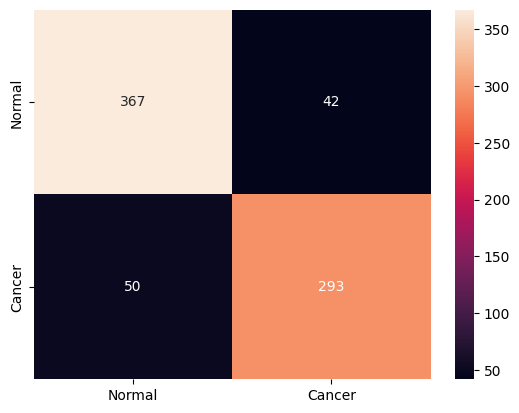

In [107]:
import sklearn as sk
cm = sk.metrics.confusion_matrix(y_test, y_pred)
cols = ['Normal', 'Cancer']

cm = pd.DataFrame((cm), index=cols, columns=cols)

import seaborn as sn
sn.heatmap(cm, annot=True, fmt='g')


# Making predictions using trained VAE/Classifier 

In [108]:
# Reload full adata - above removed spots without histopathologist annt
# for training 

iac_adata, iac_full_res_img = load_annotated_data(dataset_name='IAC')



 --------------------- 
Loading adata...


c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")



 --------------------- 
Loading histopathologist annotations...

 --------------------- 
Converting below to non-malignat excluding nan:
['Normal gland' 'Invasive carcinoma' 'Fibro-muscular tissue' nan
 'Fibrous tissue' 'Nerve' 'Immune Cells' 'Blood vessel']

Loading full resolution image...

Loading tissue positions...


c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


In [121]:
iac_adata

AnnData object with n_obs × n_vars = 4371 × 17943
    obs: 'truth_label', 'Barcode', 'in_tiss', 'arr_row', 'arr_col', 'pxl_row', 'pxl_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [109]:
# Set image resolution 
sc.set_figure_params(dpi=300, dpi_save=300, fontsize=10)

## Stage 3 adenocarcinoma 

In [112]:
# Create x around spot centres 
x = create_x_y(iac_adata, iac_full_res_img, y_available=False)

# Invert and normalize 
x_inverted = invert_image_normalize(x)

# Make prediction using trained classifier
iac_embeddings = generate_vae_embeddings(vae, x_inverted)


In [123]:
y_pred = np.round(y_pred)
np.shape(y_pred)

(752, 1)

In [124]:
def classifier_prediction(clsf, adata, embeddings):

    # Make prediction using trained classifier 
    y_pred = clsf.predict(embeddings)
    y_pred = np.round(y_pred)

    # Add predictions to adata
    adata.obs['y_pred'] = y_pred
    adata.obs['y_pred_txt'] = adata.obs['y_pred'].replace(1, 'Non-malignant').replace(0, 'Malignant')
    
    # Plot 
    col_dict = {'Non-malignant': 'g',
        'Malignant': 'r'}
    sc.pl.spatial(adata, color='y_pred_txt', palette=col_dict)
    return 

    return 



137/137 [==============================] - 1s 4ms/step


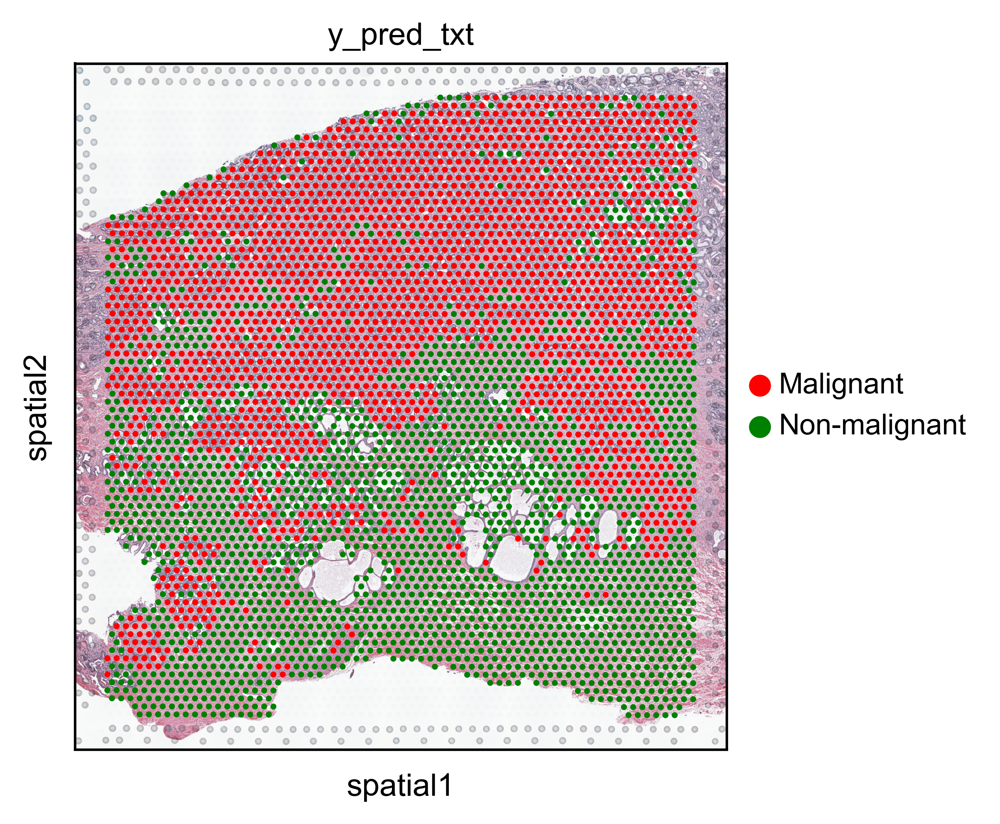

In [125]:
classifier_prediction(clsf, iac_adata, iac_embeddings)

## Normal 


 --------------------- 
Loading adata...


c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")



Loading full resolution image...

Loading tissue positions...


c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


80/80 [==============================] - 0s 2ms/step


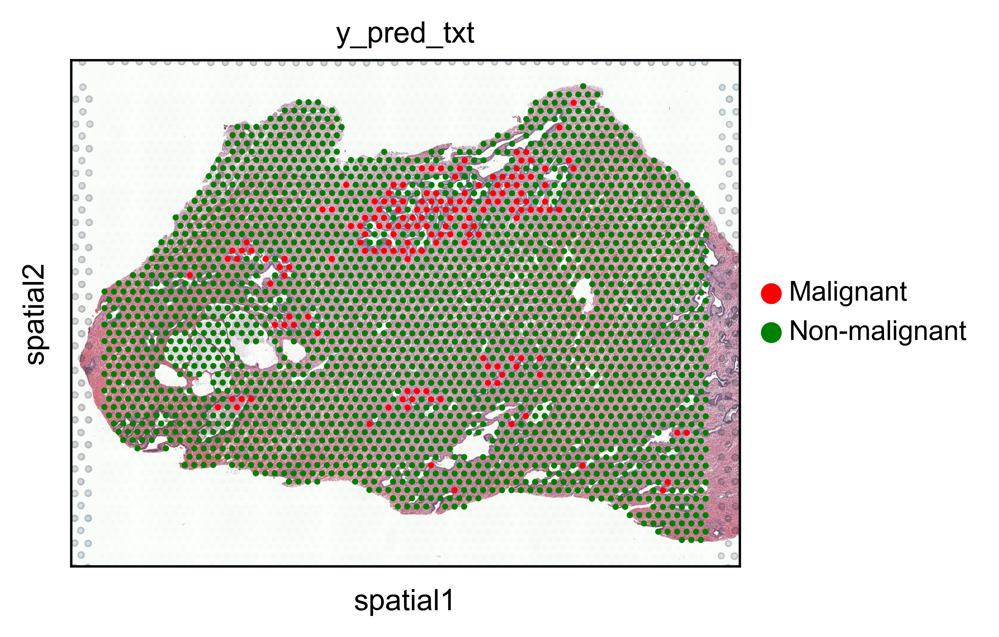

In [126]:
norm_adata, norm_full_res_img = load_annotated_data('Normal')
x = create_x_y(norm_adata, norm_full_res_img, y_available=False)
x_inverted = invert_image_normalize(x)
norm_embeddings = generate_vae_embeddings(vae, x_inverted)
classifier_prediction(clsf, norm_adata, norm_embeddings)

## ACC 


 --------------------- 
Loading adata...


c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")



Loading full resolution image...

Loading tissue positions...


c:\Users\MG\AppData\Local\Programs\Python\Python310\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


96/96 [==============================] - 0s 3ms/step


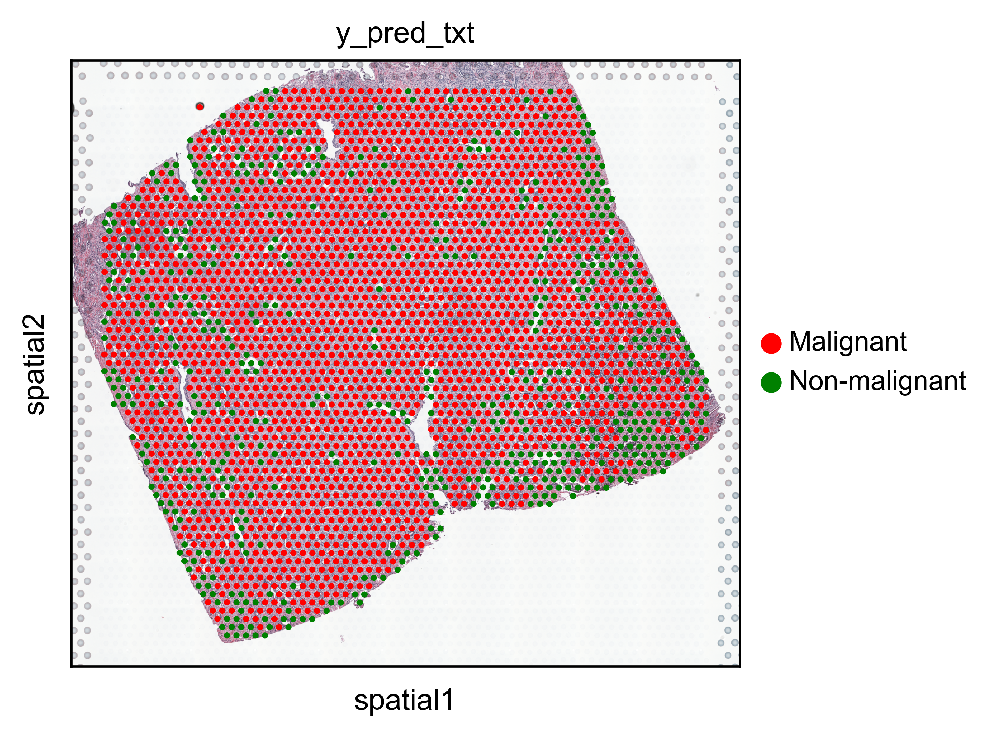

In [127]:
acc_adata, acc_full_res_img = load_annotated_data('ACC')
x = create_x_y(acc_adata, acc_full_res_img, y_available=False)
x_inverted = invert_image_normalize(x)
embeddings = generate_vae_embeddings(vae, x_inverted)
classifier_prediction(clsf, acc_adata, embeddings)

# Correlation between clusters & annotations 

In [128]:
def crosstab(km_labels, adata_list, row_name):

    for i in range(len(adata_list)):
        km_labels[i] = km_labels[i].replace(0, row_name+'_0').replace(1,row_name+'_1').replace(2,row_name+'_2').replace(3, row_name+'_3')
        cluster_labels = km_labels[i]['kmeans'].values

        # Load model predictions of cancer
        cancer_label = adata_list[i].obs['y_pred_txt']

        temp_ct = pd.crosstab(cluster_labels, cancer_label,margins=True, margins_name="Total")
        if i == 0:
            ct_merged = temp_ct
        else:
            ct_merged+=temp_ct
    return ct_merged


def generate_cross_table(col_name):
    prefix_norm_km_labels = pd.read_excel('M:/Downloads_M/full_norm_km_labels.xlsx')
    prefix_iac_km_labels = pd.read_excel('M:Downloads_M/full_iac_km_labels.xlsx')
    prefix_acc_km_labels = pd.read_excel('M:/Downloads_M/full_aac_km_labels.xlsx')

    adata_list = [norm_adata, iac_adata, acc_adata]

    prefix_km_label_list = [prefix_norm_km_labels, prefix_iac_km_labels, prefix_acc_km_labels]

    prefix_ct = crosstab(prefix_km_label_list, adata_list,col_name)
    #print(prefix_ct)
    return prefix_ct.iloc[:-1,:-1]

In [129]:
generate_cross_table('cluster')


y_pred_txt,Malignant,Non-malignant
row_0,,
cluster_0,829,1479
cluster_1,1762,291
cluster_2,2106,463
cluster_3,175,2852
